In [2]:
df = pd.read_csv('../raw_data/df_grouped_rate.csv',encoding='utf-8' )

In [9]:
cgoongu = pd.read_csv("../raw_data/cgoongoo1.csv", encoding ='utf-8')
df_merged = pd.merge(df, cgoongu, on=['district'])
df_merged.drop(['district'], axis=1, inplace =True)
df_merged.columns


Index(['year', 'code', 'sales_total', 's_store_no_of_store',
       's_store_no_of_opening', 's_store_no_of_closing', 's_work_female',
       's_float_male', 's_float_female', 'b_facil_total', 'b_apt_avg_price',
       'b_income_avg_monthly_inc', 'sales_weekday', 'sales_female',
       'sales_2030s', 'sales_06_11', 'sales_11_14', 'sales_14_17',
       'sales_17_21', 'sales_21_24', 'cgoongoo'],
      dtype='object')

In [12]:
df2=df_merged[['cgoongoo', 'sales_total', 's_store_no_of_store',
       's_store_no_of_opening', 's_store_no_of_closing', 's_work_female',
       's_float_male', 's_float_female', 'b_facil_total', 'b_apt_avg_price',
       'b_income_avg_monthly_inc', 'sales_weekday', 'sales_female',
       'sales_2030s', 'sales_06_11', 'sales_11_14', 'sales_14_17',
       'sales_17_21', 'sales_21_24']]

In [14]:
X=df2[df2.columns[1:]]

In [15]:
y=df2["cgoongoo"]

In [17]:
y=np.array(y)

In [18]:
X=np.array(X)

In [19]:
len(X)

113265

## T-SNE Visuallization

In [20]:
from sklearn.manifold import TSNE

digits_proj = TSNE(n_components=2).fit_transform(X)

In [25]:
df1= pd.DataFrame(digits_proj)
df2= pd.DataFrame(y)
df1.columns=["x","y"]
df2.columns=["cgoongu"]
df3= pd.merge(df2, df1, left_index= True, right_index=True)
df3

,cgoongu,x,y
0,11110,-15.116171,9.693451
1,11110,-8.821459,-11.175241
2,11110,-8.877280,48.381519
3,11110,28.200642,-34.053928
4,11110,20.557165,-28.377607
...,...,...,...
113260,11740,-0.147421,10.639709
113261,11740,4.147649,-43.989273
113262,11740,1.094821,31.006813
113263,11740,-9.061169,38.963966


In [26]:
df3.columns=["cgoongu","x","y"]
df3

,cgoongu,x,y
0,11110,-15.116171,9.693451
1,11110,-8.821459,-11.175241
2,11110,-8.877280,48.381519
3,11110,28.200642,-34.053928
4,11110,20.557165,-28.377607
...,...,...,...
113260,11740,-0.147421,10.639709
113261,11740,4.147649,-43.989273
113262,11740,1.094821,31.006813
113263,11740,-9.061169,38.963966


In [27]:
# df3.to_csv('../raw_data/df3.csv', index=False, encoding='utf-8')

In [30]:
fig=plt.figure(figsize=(15,14))
sns.scatterplot(x='x', 

                y='y', 

                hue='cgoongu',

                size=1,

                data=df3)

plt.show()


In [31]:
fig.savefig('temp.png', transparent=True)

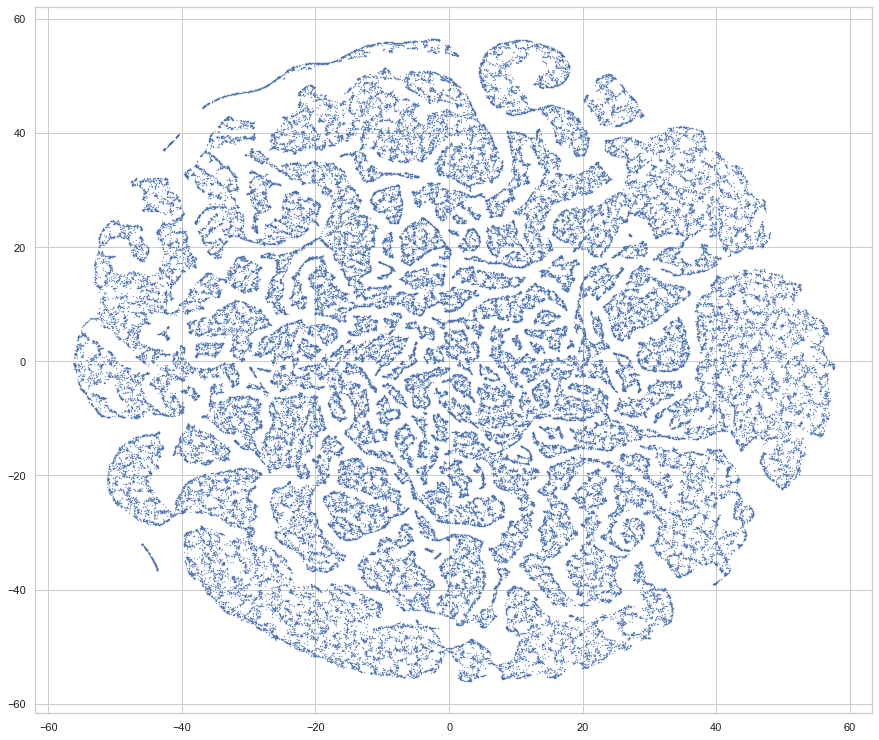

In [20]:
plt.figure(figsize=(15,13))
plt.scatter(digits_proj[:, 0], digits_proj[:, 1],s=0.1 )
plt.show()

## Clustering

In [23]:
## KMEANS
from sklearn.cluster import KMeans
model = KMeans(init="k-means++", n_clusters=10, random_state=0)
model.fit(digits_proj)
y_pred = model.labels_
len(np.unique(y_pred))

10

In [28]:
digits_proj[0]

array([-33.018387, -28.586468], dtype=float32)

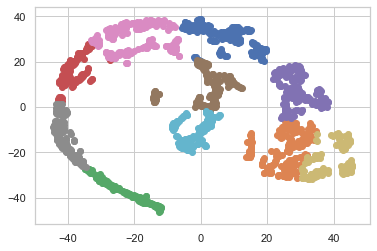

In [31]:
plt.figure()
for idx in np.unique(y_pred):
    mask = y_pred == idx
    plt.scatter(digits_proj[mask, 0], digits_proj[mask, 1])
plt.show()

In [24]:
from sklearn.metrics import confusion_matrix

confusion_matrix(y, y_pred)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [2, 0, 3, ..., 0, 0, 0],
       [0, 0, 2, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 0]], dtype=int64)

In [25]:
from sklearn.metrics.cluster import adjusted_mutual_info_score, adjusted_rand_score, silhouette_score

print("ARI:", adjusted_rand_score(y, y_pred))
print("AMI:", adjusted_mutual_info_score(y, y_pred))

ARI: 0.02401546173899257
AMI: 0.14861756427959383


In [17]:
X

array([[3.26388534e+09, 1.65000000e+01, 2.00000000e+00, ...,
        1.64275016e-01, 3.45821596e-01, 1.20878394e-01],
       [7.51999998e+08, 2.00000000e+00, 1.00000000e+00, ...,
        1.73301111e-01, 3.63920792e-01, 8.29009843e-03],
       [1.65000002e+08, 2.00000000e+00, 0.00000000e+00, ...,
        5.72191266e-02, 2.27560815e-01, 1.82710477e-01],
       ...,
       [1.79413240e+07, 1.00000000e+00, 0.00000000e+00, ...,
        2.75611878e-01, 2.09428858e-01, 0.00000000e+00],
       [8.94227000e+06, 3.00000000e+00, 0.00000000e+00, ...,
        2.27190076e-01, 2.58815044e-01, 0.00000000e+00],
       [3.68774000e+06, 6.00000000e+00, 0.00000000e+00, ...,
        1.66233791e-01, 7.03896153e-01, 0.00000000e+00]])

In [ ]:
from sklearn.cluster import DBSCAN

model = DBSCAN(eps=20, min_samples = 3)
y_pred = model.fit_predict(digits_proj)
len(np.unique(y_pred))

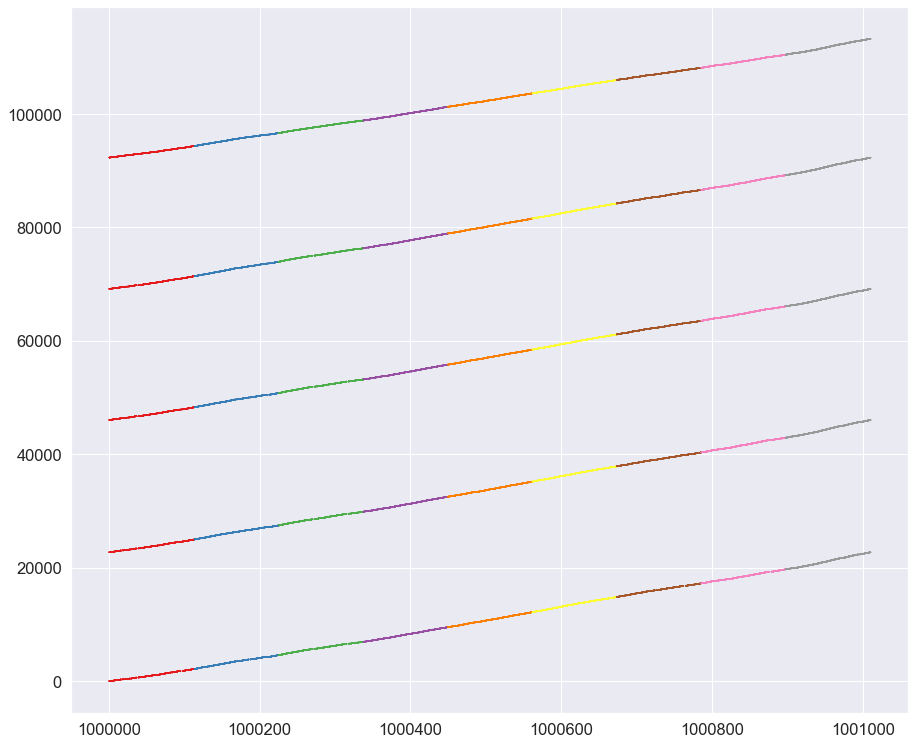

In [94]:
plt.figure(figsize=(15,13))
plt.scatter(y, y_pred,s=0.1 ,c=y, cmap=plt.cm.Set1)
plt.show()

In [ ]:
from sklearn.cluster import DBSCAN

model = DBSCAN(eps=21, min_samples = 5)
y_pred = model.fit_predict(digits_proj)
len(np.unique(y_pred))